In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


import scipy.stats as stats
import pandas_profiling


plt.rcParams['figure.figsize'] = 10, 7.5
plt.rcParams['axes.grid'] = True

from matplotlib.backends.backend_pdf import PdfPages

In [6]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [7]:
#Load the dataset

credit = pd.read_csv("C:/Data Sets/(Class 21-Python - Case Study)/4. Segmentation of Credit Card Customers/CC_GENERAL.csv")

In [8]:
#Data Inspection
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
CUST_ID                             8950 non-null object
BALANCE                             8950 non-null float64
BALANCE_FREQUENCY                   8950 non-null float64
PURCHASES                           8950 non-null float64
ONEOFF_PURCHASES                    8950 non-null float64
INSTALLMENTS_PURCHASES              8950 non-null float64
CASH_ADVANCE                        8950 non-null float64
PURCHASES_FREQUENCY                 8950 non-null float64
ONEOFF_PURCHASES_FREQUENCY          8950 non-null float64
PURCHASES_INSTALLMENTS_FREQUENCY    8950 non-null float64
CASH_ADVANCE_FREQUENCY              8950 non-null float64
CASH_ADVANCE_TRX                    8950 non-null int64
PURCHASES_TRX                       8950 non-null int64
CREDIT_LIMIT                        8949 non-null float64
PAYMENTS                            8950 non-null float64
MINIMUM_PAYMENTS            

In [5]:
#Detailed profiling using pandas profiling

pandas_profiling.ProfileReport(credit)

In [6]:
#Exporting pandas profiling output to html file

output = pandas_profiling.ProfileReport(credit)

output.to_file('C:/Data Sets/(Class 21-Python - Case Study)/4. Segmentation of Credit Card Customers/pandas_profiling.html')

In [9]:
#Total no. of columns in the dataset
len(credit.columns)

18

In [10]:
#Separating Categorical and Numerical variables
numeric_var_names=[key for key in dict(credit.dtypes) if dict(credit.dtypes)[key] in ['float64', 'int64', 'float32', 'int32']]
cat_var_names=[key for key in dict(credit.dtypes) if dict(credit.dtypes)[key] in ['object']]
print(numeric_var_names)
print(cat_var_names)

['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE']
['CUST_ID']


In [11]:
len(credit.columns)
len(numeric_var_names)

#All variables are numeric except CUST_ID which is Categorical.
#We will disregard CUST_ID anyways as it is not of significance.

17

In [12]:
credit_cat = credit[cat_var_names]
credit_cat.head(5)

credit_num=credit[numeric_var_names]
credit_num.head(5)

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [13]:
# Creating Data audit Report
# Use a general function that returns multiple values
def var_summary(x):
    return pd.Series([x.count(), x.isnull().sum(), x.sum(), x.mean(), x.median(),  x.std(), x.var(), x.min(), x.dropna().quantile(0.01), 
                      x.dropna().quantile(0.05),x.dropna().quantile(0.10),x.dropna().quantile(0.25),x.dropna().quantile(0.50),x.dropna().quantile(0.75), 
                      x.dropna().quantile(0.90),x.dropna().quantile(0.95), x.dropna().quantile(0.99),x.max()], 
                  index=['N', 'NMISS', 'SUM', 'MEAN','MEDIAN', 'STD', 'VAR', 'MIN', 'P1' , 'P5' ,'P10' ,'P25' ,'P50' ,'P75' ,'P90' ,'P95' ,'P99' ,'MAX'])

num_summary=credit_num.apply(var_summary)

In [14]:
credit_num.apply(var_summary).round(2)

#We have outliers in our data and missing values in some columns.

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
N,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8949.00,8950.00,8637.00,8950.00,8950.00
NMISS,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,313.00,0.00,0.00
SUM,14002049.71,7851.57,8978683.26,5302314.47,3679055.42,8760896.46,4388.64,1812.00,3261.71,1209.54,29077.00,131653.00,40220828.13,15511637.48,7464151.91,1375.75,103080.00
MEAN,1564.47,0.88,1003.20,592.44,411.07,978.87,0.49,0.20,0.36,0.14,3.25,14.71,4494.45,1733.14,864.21,0.15,11.52
MEDIAN,873.39,1.00,361.28,38.00,89.00,0.00,0.50,0.08,0.17,0.00,0.00,7.00,3000.00,856.90,312.34,0.00,12.00
STD,2081.53,0.24,2136.63,1659.89,904.34,2097.16,0.40,0.30,0.40,0.20,6.82,24.86,3638.82,2895.06,2372.45,0.29,1.34
VAR,4332774.97,0.06,4565208.19,2755227.90,817827.43,4398096.33,0.16,0.09,0.16,0.04,46.58,617.90,13240979.88,8381394.16,5628502.90,0.09,1.79
MIN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,50.00,0.00,0.02,0.00,6.00
P1,0.07,0.09,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,500.00,0.00,19.52,0.00,6.00
P5,8.81,0.27,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1000.00,89.99,73.28,0.00,8.00


In [15]:
#Handling Outliers - at 99%tile or 95%tile if required after including some particular vars like income
def outlier_capping(x):
    x = x.clip(upper=x.quantile(0.99))
    x = x.clip(lower=x.quantile(0.01))
    return x

credit_num=credit_num.apply(lambda x: outlier_capping(x))

In [16]:
#Handling missings - Method2
def Missing_imputation(x):
    x = x.fillna(x.mean())
    return x

credit_num=credit_num.apply(lambda x: Missing_imputation(x))

In [17]:
#Checking the corelation between the data and importing it to excel for analysis
credit_corr = credit_num.corr()
credit_corr.to_excel('C:/Data Sets/(Class 21-Python - Case Study)/4. Segmentation of Credit Card Customers/corr.xlsx')

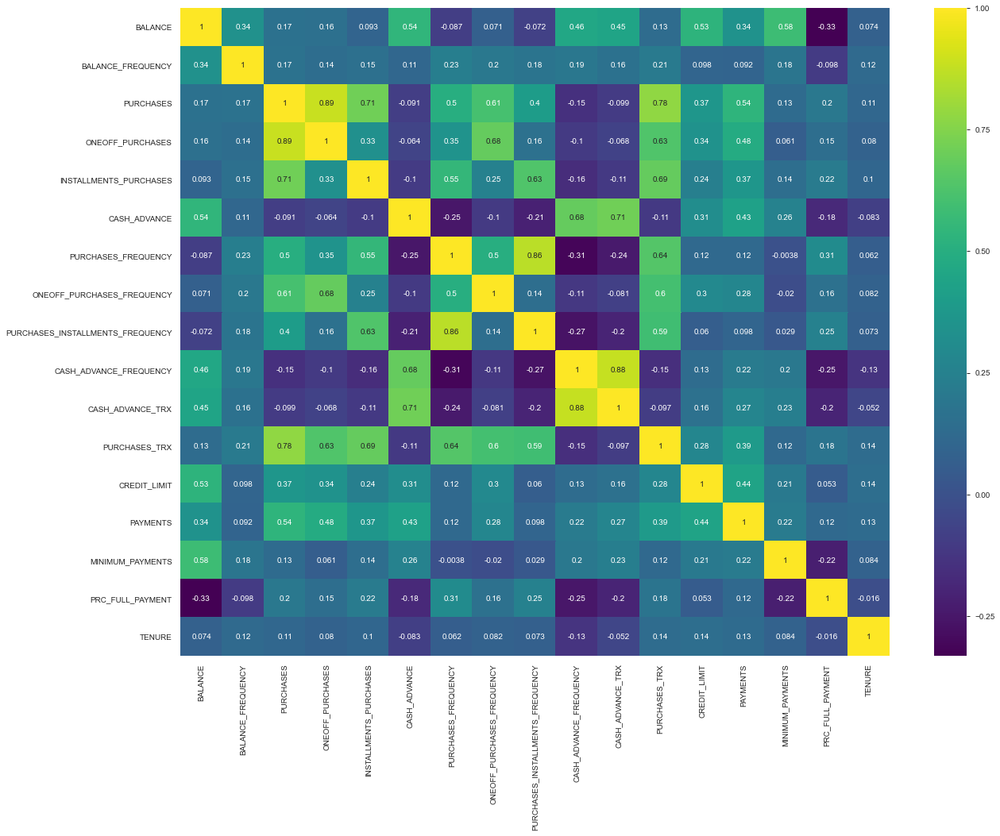

In [20]:
plt.subplots(figsize=(20,15))
sns.heatmap(credit_num.corr(),cmap = 'viridis', annot = True)
plt.show()

In [21]:
#Monthly average purchase and cash advance amount
credit_num.PURCHASES.mean()

936.2292368715101

In [22]:
#Purchases by type (one-off, installments)
credit_num.ONEOFF_PURCHASES.mean()
credit_num.INSTALLMENTS_PURCHASES.mean()

384.4983681564239

In [23]:
#Limit usage (balance to credit limit ratio)

credit_num.BALANCE/credit_num.CREDIT_LIMIT

0       0.040901
1       0.457495
2       0.332687
3       0.222223
4       0.681429
          ...   
8945    0.028494
8946    0.019183
8947    0.023399
8948    0.026915
8949    0.310590
Length: 8950, dtype: float64

In [24]:
#Payments to minimum payments ratio etc

credit_num.PAYMENTS/credit_num.MINIMUM_PAYMENTS

0       1.446508
1       3.826241
2       0.991682
3       0.000000
4       2.771075
          ...   
8945    6.660231
8946    0.359520
8947    0.986076
8948    0.942505
8949    0.715439
Length: 8950, dtype: float64

In [25]:
credit_num.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE'],
      dtype='object')

# Feature Selection
We will talk about initial feature selection now.
We have already removed CUST_ID as it is a categorical variable with high cardinality.
PURCHASES and ONEOFF_PURCHASES have a very high correlation with each other and we will take a step and remove ONEOFF_PURCHASES
as PURCHASES is a more important variable based on the context.
Removed Tenure as it does not impact the marketing decisions of the credit card company.

In [26]:
credit_num.drop(['ONEOFF_PURCHASES','TENURE'], axis=1, inplace=True)

In [27]:
credit_num.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT
0,40.900749,0.818182,95.40,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2.0,1000.0,201.802084,139.509787,0.000000
1,3202.467416,0.909091,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0.0,7000.0,4103.032597,1072.340217,0.222222
2,2495.148862,1.000000,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12.0,7500.0,622.066742,627.284787,0.000000
3,1666.670542,0.636364,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1.0,7500.0,0.000000,767.303879,0.000000
4,817.714335,1.000000,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1.0,1200.0,678.334763,244.791237,0.000000


In [28]:
len(credit_num.columns)

15

In [29]:
#Standardizing the variables

sc = StandardScaler()
credit_scaled = sc.fit_transform(credit_num)

In [30]:
pd.DataFrame(credit_scaled)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,-0.762856,-0.255968,-0.551327,-0.427513,-0.527079,-0.806490,-0.678661,-0.707313,-0.685371,-0.557505,-0.579714,-0.978471,-0.642945,-4.999171e-01,-0.525551
1,0.844867,0.132501,-0.613881,-0.568588,3.101370,-1.221758,-0.678661,-0.916995,0.593147,0.166685,-0.675130,0.711257,1.089747,2.429027e-01,0.234227
2,0.485181,0.520970,-0.106917,-0.568588,-0.527079,1.269843,2.673451,-0.916995,-0.685371,-0.557505,-0.102638,0.852068,-0.456289,-1.114982e-01,-0.525551
3,0.063882,-1.032906,0.369006,-0.568588,-0.411186,-1.014125,-0.399319,-0.916995,-0.259200,-0.376457,-0.627422,0.852068,-0.732573,-1.086356e-15,-0.525551
4,-0.367830,0.520970,-0.603389,-0.568588,-0.527079,-1.014125,-0.399319,-0.916995,-0.685371,-0.557505,-0.627422,-0.922146,-0.431298,-4.160807e-01,-0.525551
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,-0.769165,0.520970,-0.422995,-0.138086,-0.527079,1.269843,-0.678661,1.179833,-0.685371,-0.557505,-0.388884,-0.978471,-0.587964,-5.720812e-01,1.183951
8946,-0.773899,0.520970,-0.417172,-0.124954,-0.527079,1.269843,-0.678661,1.179833,-0.685371,-0.557505,-0.388884,-0.978471,-0.610052,-1.086356e-15,-0.525551
8947,-0.771756,-0.191225,-0.519198,-0.355053,-0.527079,0.854576,-0.678661,0.760469,-0.685371,-0.557505,-0.436591,-0.978471,-0.696478,-5.453794e-01,0.329200
8948,-0.776811,-0.191225,-0.613881,-0.568588,-0.506490,-1.221758,-0.678661,-0.916995,0.166976,-0.195410,-0.675130,-1.119281,-0.709234,-5.666112e-01,0.329200


In [31]:
#Summarizing the Standardizied variables
pd.DataFrame(credit_scaled).apply(var_summary).round(2)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
N,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00,8950.00
NMISS,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
SUM,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00
MEAN,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00
MEDIAN,-0.34,0.52,-0.38,-0.44,-0.53,0.02,-0.40,-0.50,-0.69,-0.56,-0.34,-0.42,-0.35,-0.34,-0.53
STD,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
VAR,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
MIN,-0.78,-3.36,-0.61,-0.57,-0.53,-1.22,-0.68,-0.92,-0.69,-0.56,-0.68,-1.12,-0.73,-0.60,-0.53
P1,-0.78,-3.36,-0.61,-0.57,-0.53,-1.22,-0.68,-0.92,-0.69,-0.56,-0.68,-1.12,-0.73,-0.60,-0.53
P5,-0.78,-2.59,-0.61,-0.57,-0.53,-1.22,-0.68,-0.92,-0.69,-0.56,-0.68,-0.98,-0.69,-0.55,-0.53


## Applying PCA for variable reduction/checking multicollinearity

In [32]:
pca = PCA(n_components = 15)

In [33]:
pca.fit(credit_scaled)

PCA(copy=True, iterated_power='auto', n_components=15, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [34]:
pca.explained_variance_ #Eigen value

array([4.46325227, 3.70182915, 1.29412587, 1.1549959 , 0.99607844,
       0.75393786, 0.63734165, 0.58852596, 0.44414506, 0.26153478,
       0.21954837, 0.19444925, 0.14184391, 0.108889  , 0.04117868])

In [35]:
sum(pca.explained_variance_)

15.001676164934631

In [36]:
#The amount of variance that each PC explains
var= pca.explained_variance_ratio_
var

array([0.29751691, 0.24676104, 0.08626542, 0.07699112, 0.06639781,
       0.05025691, 0.0424847 , 0.03923068, 0.02960636, 0.0174337 ,
       0.01463492, 0.01296184, 0.0094552 , 0.00725846, 0.00274494])

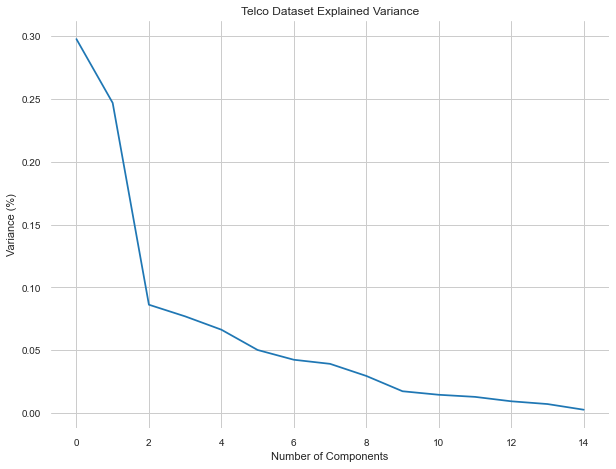

In [37]:
# Screen Plot - Plotting Explained Variance % by each componet
plt.figure()
plt.plot(var)
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Telco Dataset Explained Variance')
plt.show()

In [38]:
#Cumulative Variance explains
var1=np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)

In [39]:
pd.DataFrame({'Eigen_value': pca.explained_variance_, 'Cumm_variance':var1})

,Eigen_value,Cumm_variance
0,4.463252,29.75
1,3.701829,54.43
2,1.294126,63.06
3,1.154996,70.76
4,0.996078,77.40
5,0.753938,82.43
6,0.637342,86.68
7,0.588526,90.60
8,0.444145,93.56
9,0.261535,95.30


In [40]:
#We can choose 4 or 5 components based on the Eigen values.
#We will go with 4 components as the multicollinearity is negiligble and cumm variance captures 77.40 variance of the data.

In [41]:
pc_final = PCA(n_components = 4)
pc_final.fit(credit_scaled)

PCA(copy=True, iterated_power='auto', n_components=4, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [42]:
pc_final.explained_variance_

array([4.46325227, 3.70182915, 1.29412587, 1.1549959 ])

In [43]:
pc_final.explained_variance_ratio_

array([0.29751691, 0.24676104, 0.08626542, 0.07699112])

In [44]:
reduced_cr=pc_final.fit_transform(credit_scaled)

In [45]:
dimensions = pd.DataFrame(reduced_cr)

In [46]:
dimensions.columns = ["C1", "C2", "C3", "C4"]

In [47]:
print(credit_scaled.shape)

print(dimensions.shape)
#pd.DataFrame(telco_scaled).head()
print(dimensions.head())


(8950, 15)
(8950, 4)
         C1        C2        C3        C4
0 -1.588324 -1.629338 -0.188105  0.376208
1 -1.782556  2.524372  1.174063 -0.014774
2  0.936555 -0.211807  0.017681  1.594370
3 -1.238319 -0.379817  0.612054  1.500082
4 -1.600077 -1.193604 -0.394782  0.636604


## Clustering/Segmentation

In [48]:
km_3=KMeans(n_clusters=3,random_state=123).fit(dimensions)
km_4=KMeans(n_clusters=4,random_state=123).fit(dimensions)
km_5=KMeans(n_clusters=5,random_state=123).fit(dimensions)
km_6=KMeans(n_clusters=6,random_state=123).fit(dimensions)
km_7=KMeans(n_clusters=7,random_state=123).fit(dimensions)
km_8=KMeans(n_clusters=8,random_state=123).fit(dimensions)

In [49]:
credit_num['cluster_3'] = km_3.labels_
credit_num['cluster_4'] = km_4.labels_
credit_num['cluster_5'] = km_5.labels_
credit_num['cluster_6'] = km_6.labels_
credit_num['cluster_7'] = km_7.labels_
credit_num['cluster_8'] = km_8.labels_

In [50]:
credit_num

,BALANCE,BALANCE_FREQUENCY,PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,...,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8
0,40.900749,0.818182,95.40,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,...,1000.0,201.802084,139.509787,0.000000,0,1,0,4,4,6
1,3202.467416,0.909091,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,...,7000.0,4103.032597,1072.340217,0.222222,1,3,4,2,2,3
2,2495.148862,1.000000,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,...,7500.0,622.066742,627.284787,0.000000,0,2,3,1,1,2
3,1666.670542,0.636364,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,...,7500.0,0.000000,767.303879,0.000000,0,1,0,4,4,6
4,817.714335,1.000000,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,...,1200.0,678.334763,244.791237,0.000000,0,1,0,4,4,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,...,1000.0,325.594462,48.886365,0.500000,0,2,3,5,6,1
8946,19.183215,1.000000,300.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,...,1000.0,275.861322,767.303879,0.000000,0,2,3,5,6,1
8947,23.398673,0.833333,144.40,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,...,1000.0,81.270775,82.418369,0.250000,0,2,3,5,6,1
8948,13.457564,0.833333,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,...,500.0,52.549959,55.755628,0.250000,0,1,0,4,4,6


In [51]:
pd.Series(km_3.labels_).value_counts()/sum(pd.Series(km_3.labels_).value_counts())

0    0.642235
2    0.184358
1    0.173408
dtype: float64

In [52]:
pd.Series(km_4.labels_).value_counts()/sum(pd.Series(km_4.labels_).value_counts())

1    0.425810
2    0.338547
3    0.151061
0    0.084581
dtype: float64

In [53]:
pd.Series(km_5.labels_).value_counts()/sum(pd.Series(km_5.labels_).value_counts())

0    0.324581
3    0.315196
4    0.202123
2    0.083687
1    0.074413
dtype: float64

In [54]:
pd.Series(km_6.labels_).value_counts()/sum(pd.Series(km_6.labels_).value_counts())

4    0.313184
5    0.244022
2    0.200223
1    0.133855
0    0.074413
3    0.034302
dtype: float64

In [55]:
pd.Series(km_7.labels_).value_counts()/sum(pd.Series(km_7.labels_).value_counts())

4    0.266369
6    0.235642
5    0.150279
2    0.134525
1    0.131285
0    0.048380
3    0.033520
dtype: float64

In [56]:
pd.Series(km_8.labels_).value_counts()/sum(pd.Series(km_8.labels_).value_counts())

6    0.249609
1    0.237989
0    0.142793
3    0.118771
4    0.116313
2    0.056872
5    0.045475
7    0.032179
dtype: float64

## Quantitative Analysis
Choosing number clusters using Silhouette Coefficient

In [57]:
from sklearn import metrics
metrics.silhouette_score(dimensions, km_3.labels_)

0.34187860397119824

In [58]:
# calculate SC for K=3 through K=12
k_range = range(2, 20)
scores = []
for k in k_range:
    km = KMeans(n_clusters=k, random_state=123)
    km.fit(dimensions)
    scores.append(metrics.silhouette_score(dimensions, km.labels_))

In [59]:
scores

[0.2989323835586102,
 0.34187860397119824,
 0.3085544208954574,
 0.2668093473557167,
 0.26095043138741225,
 0.2590139137209405,
 0.267894016629281,
 0.26584053303738775,
 0.27017637959785984,
 0.2601524778407454,
 0.25877414941594296,
 0.25891148007434106,
 0.24371053190053094,
 0.2466475040938703,
 0.23993606290548258,
 0.24338258243597383,
 0.24585571430855743,
 0.25370888972763933]

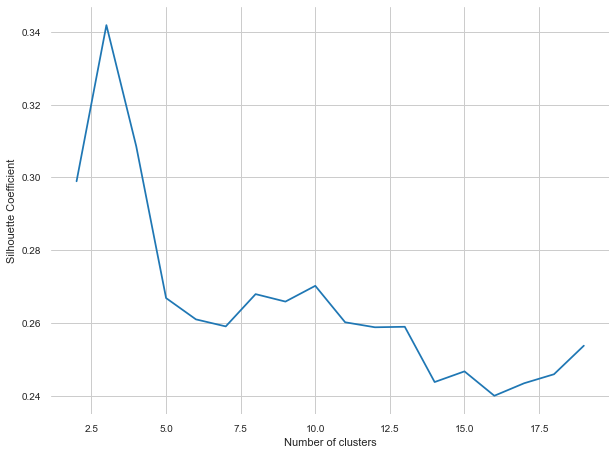

In [60]:
# plot the results
plt.plot(k_range, scores)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Coefficient')
plt.grid(True)

## Note:

The solution can be 3-7 based on the SC score. If we take highest SC score, 3 segment solution is best. But 3 is highly skewed.

## Elbow Analysis

In [61]:
cluster_range = range( 2, 20 )
cluster_errors = []

for num_clusters in cluster_range:
    clusters = KMeans( num_clusters )
    clusters.fit( dimensions )
    cluster_errors.append( clusters.inertia_ )

In [62]:
clusters_df = pd.DataFrame( { "num_clusters":cluster_range, "cluster_errors": cluster_errors } )

clusters_df[0:10]

,num_clusters,cluster_errors
0,2,68748.658954
1,3,50732.613979
2,4,40163.944457
3,5,35955.823125
4,6,32562.494759
5,7,29772.899739
6,8,27347.988720
7,9,25784.935013
8,10,24392.859604
9,11,23208.079453


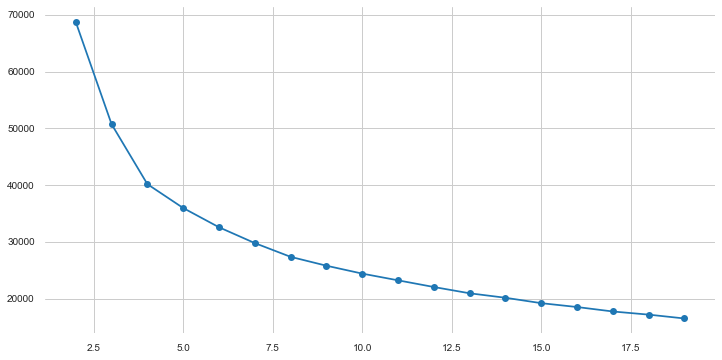

In [63]:
# allow plots to appear in the notebook
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(12,6))
plt.plot( clusters_df.num_clusters, clusters_df.cluster_errors, marker = "o" )

## Note:
The elbow diagram shows that the gain in explained variance reduces significantly from 3 to 4 to 5. So, optimal number of clusters could either 4 or 5.
The actual number of clusters chosen can be finally based on business context and convenience of dealing with number of segments or clusters.

# Qualitative Analysis with Profiling

In [64]:
credit_num.cluster_3.value_counts()*100/sum(credit_num.cluster_3.value_counts())

0    64.223464
2    18.435754
1    17.340782
Name: cluster_3, dtype: float64

In [65]:
size=pd.concat([pd.Series(credit_num.cluster_3.size), pd.Series.sort_index(credit_num.cluster_3.value_counts()), pd.Series.sort_index(credit_num.cluster_4.value_counts()),
           pd.Series.sort_index(credit_num.cluster_5.value_counts()), pd.Series.sort_index(credit_num.cluster_6.value_counts()),
           pd.Series.sort_index(credit_num.cluster_7.value_counts()), pd.Series.sort_index(credit_num.cluster_8.value_counts())])


In [66]:
Seg_size=pd.DataFrame(size, columns=['Seg_size'])
Seg_Pct = pd.DataFrame(size/credit_num.cluster_3.size, columns=['Seg_Pct'])

In [67]:
pd.concat([Seg_size.T, Seg_Pct.T], axis=0)

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,8950.0,5748.000000,1552.000000,1650.000000,757.000000,3811.00000,3030.000000,1352.000000,2905.000000,666.000000,...,1345.000000,2109.000000,1278.000000,2130.000000,509.000000,1063.000000,1041.000000,407.000000,2234.000000,288.000000
Seg_Pct,1.0,0.642235,0.173408,0.184358,0.084581,0.42581,0.338547,0.151061,0.324581,0.074413,...,0.150279,0.235642,0.142793,0.237989,0.056872,0.118771,0.116313,0.045475,0.249609,0.032179


In [68]:
# Mean value gives a good indication of the distribution of data. So we are finding mean value for each variable for each cluster
Profling_output = pd.concat([credit_num.apply(lambda x: x.mean()).T, credit_num.groupby('cluster_3').apply(lambda x: x.mean()).T, credit_num.groupby('cluster_4').apply(lambda x: x.mean()).T,
          credit_num.groupby('cluster_5').apply(lambda x: x.mean()).T, credit_num.groupby('cluster_6').apply(lambda x: x.mean()).T,
          credit_num.groupby('cluster_7').apply(lambda x: x.mean()).T, credit_num.groupby('cluster_8').apply(lambda x: x.mean()).T], axis=1)

In [69]:
Profling_output

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
BALANCE,1541.046707,799.077289,3915.351195,1892.513160,2831.814904,989.862307,759.296615,4124.001588,582.291123,5043.215700,...,104.397873,543.839448,102.264855,543.411862,4762.760684,2563.787158,1093.523889,5543.286418,1264.101173,3945.060340
BALANCE_FREQUENCY,0.878083,0.827543,0.959210,0.977841,0.985105,0.785292,0.929292,0.964955,0.718434,0.971424,...,0.439039,0.925722,0.429825,0.925058,0.993679,0.942133,0.971135,0.979060,0.957118,0.986995
PURCHASES,936.229237,426.472171,416.532036,3200.867824,4766.988666,269.455998,1042.185439,433.374675,329.711959,685.832207,...,387.509621,733.698388,399.787613,729.720615,1127.854342,198.055118,2671.184352,846.070688,223.892064,6611.733299
INSTALLMENTS_PURCHASES,384.498368,186.581768,136.572230,1307.168663,1708.794775,52.381165,577.469835,146.704534,73.895205,238.911412,...,97.205138,519.526278,97.471354,497.287023,355.223400,55.303368,1067.794366,312.964276,37.150497,2416.423087
CASH_ADVANCE,935.920972,343.352458,3736.518135,365.955533,593.458763,531.947828,173.250278,3975.623448,244.697686,5415.998406,...,239.439365,145.854835,215.049713,139.698798,1210.368562,2827.736674,223.766367,6321.629097,530.127684,666.631829
PURCHASES_FREQUENCY,0.490351,0.427328,0.239648,0.945712,0.957040,0.175486,0.873574,0.257730,0.225990,0.349045,...,0.254053,0.878200,0.253613,0.870086,0.566472,0.152535,0.940727,0.397939,0.152522,0.967940
ONEOFF_PURCHASES_FREQUENCY,0.202458,0.126674,0.116123,0.547667,0.688513,0.094066,0.251119,0.126787,0.110038,0.175020,...,0.119677,0.134325,0.118012,0.148017,0.269159,0.079214,0.604940,0.198474,0.090188,0.738526
PURCHASES_INSTALLMENTS_FREQUENCY,0.364437,0.304974,0.147923,0.775239,0.793267,0.078310,0.709227,0.158147,0.111199,0.230216,...,0.127478,0.774063,0.128849,0.751652,0.362880,0.077761,0.699824,0.278795,0.061410,0.866262
CASH_ADVANCE_FREQUENCY,0.134017,0.072587,0.445219,0.055297,0.072343,0.103395,0.039947,0.465685,0.049033,0.548913,...,0.031559,0.037256,0.026717,0.035578,0.142247,0.424093,0.040312,0.593450,0.116451,0.078672
CASH_ADVANCE_TRX,3.079330,1.271399,11.780928,1.192727,1.797886,1.839675,0.728713,12.559172,0.769019,16.397898,...,0.577695,0.669986,0.474178,0.632394,2.964637,10.105362,0.782901,18.609337,1.964190,2.010417


In [70]:
Profling_output_final=pd.concat([Seg_size.T, Seg_Pct.T, Profling_output], axis=0)

In [71]:
Profling_output_final

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,8950.000000,5748.000000,1552.000000,1650.000000,757.000000,3811.000000,3030.000000,1352.000000,2905.000000,666.000000,...,1345.000000,2109.000000,1278.000000,2130.000000,509.000000,1063.000000,1041.000000,407.000000,2234.000000,288.000000
Seg_Pct,1.000000,0.642235,0.173408,0.184358,0.084581,0.425810,0.338547,0.151061,0.324581,0.074413,...,0.150279,0.235642,0.142793,0.237989,0.056872,0.118771,0.116313,0.045475,0.249609,0.032179
BALANCE,1541.046707,799.077289,3915.351195,1892.513160,2831.814904,989.862307,759.296615,4124.001588,582.291123,5043.215700,...,104.397873,543.839448,102.264855,543.411862,4762.760684,2563.787158,1093.523889,5543.286418,1264.101173,3945.060340
BALANCE_FREQUENCY,0.878083,0.827543,0.959210,0.977841,0.985105,0.785292,0.929292,0.964955,0.718434,0.971424,...,0.439039,0.925722,0.429825,0.925058,0.993679,0.942133,0.971135,0.979060,0.957118,0.986995
PURCHASES,936.229237,426.472171,416.532036,3200.867824,4766.988666,269.455998,1042.185439,433.374675,329.711959,685.832207,...,387.509621,733.698388,399.787613,729.720615,1127.854342,198.055118,2671.184352,846.070688,223.892064,6611.733299
INSTALLMENTS_PURCHASES,384.498368,186.581768,136.572230,1307.168663,1708.794775,52.381165,577.469835,146.704534,73.895205,238.911412,...,97.205138,519.526278,97.471354,497.287023,355.223400,55.303368,1067.794366,312.964276,37.150497,2416.423087
CASH_ADVANCE,935.920972,343.352458,3736.518135,365.955533,593.458763,531.947828,173.250278,3975.623448,244.697686,5415.998406,...,239.439365,145.854835,215.049713,139.698798,1210.368562,2827.736674,223.766367,6321.629097,530.127684,666.631829
PURCHASES_FREQUENCY,0.490351,0.427328,0.239648,0.945712,0.957040,0.175486,0.873574,0.257730,0.225990,0.349045,...,0.254053,0.878200,0.253613,0.870086,0.566472,0.152535,0.940727,0.397939,0.152522,0.967940
ONEOFF_PURCHASES_FREQUENCY,0.202458,0.126674,0.116123,0.547667,0.688513,0.094066,0.251119,0.126787,0.110038,0.175020,...,0.119677,0.134325,0.118012,0.148017,0.269159,0.079214,0.604940,0.198474,0.090188,0.738526
PURCHASES_INSTALLMENTS_FREQUENCY,0.364437,0.304974,0.147923,0.775239,0.793267,0.078310,0.709227,0.158147,0.111199,0.230216,...,0.127478,0.774063,0.128849,0.751652,0.362880,0.077761,0.699824,0.278795,0.061410,0.866262


In [72]:
Profling_output_final.columns = ['Overall', 'KM3_1', 'KM3_2', 'KM3_3',
                                'KM4_1', 'KM4_2', 'KM4_3', 'KM4_4',
                                'KM5_1', 'KM5_2', 'KM5_3', 'KM5_4', 'KM5_5',
                                'KM6_1', 'KM6_2', 'KM6_3', 'KM6_4', 'KM6_5','KM6_6',
                                'KM7_1', 'KM7_2', 'KM7_3', 'KM7_4', 'KM7_5','KM7_6','KM7_7',
                                'KM8_1', 'KM8_2', 'KM8_3', 'KM8_4', 'KM8_5','KM8_6','KM8_7','KM8_8',]

In [73]:
Profling_output_final

,Overall,KM3_1,KM3_2,KM3_3,KM4_1,KM4_2,KM4_3,KM4_4,KM5_1,KM5_2,...,KM7_6,KM7_7,KM8_1,KM8_2,KM8_3,KM8_4,KM8_5,KM8_6,KM8_7,KM8_8
Seg_size,8950.000000,5748.000000,1552.000000,1650.000000,757.000000,3811.000000,3030.000000,1352.000000,2905.000000,666.000000,...,1345.000000,2109.000000,1278.000000,2130.000000,509.000000,1063.000000,1041.000000,407.000000,2234.000000,288.000000
Seg_Pct,1.000000,0.642235,0.173408,0.184358,0.084581,0.425810,0.338547,0.151061,0.324581,0.074413,...,0.150279,0.235642,0.142793,0.237989,0.056872,0.118771,0.116313,0.045475,0.249609,0.032179
BALANCE,1541.046707,799.077289,3915.351195,1892.513160,2831.814904,989.862307,759.296615,4124.001588,582.291123,5043.215700,...,104.397873,543.839448,102.264855,543.411862,4762.760684,2563.787158,1093.523889,5543.286418,1264.101173,3945.060340
BALANCE_FREQUENCY,0.878083,0.827543,0.959210,0.977841,0.985105,0.785292,0.929292,0.964955,0.718434,0.971424,...,0.439039,0.925722,0.429825,0.925058,0.993679,0.942133,0.971135,0.979060,0.957118,0.986995
PURCHASES,936.229237,426.472171,416.532036,3200.867824,4766.988666,269.455998,1042.185439,433.374675,329.711959,685.832207,...,387.509621,733.698388,399.787613,729.720615,1127.854342,198.055118,2671.184352,846.070688,223.892064,6611.733299
INSTALLMENTS_PURCHASES,384.498368,186.581768,136.572230,1307.168663,1708.794775,52.381165,577.469835,146.704534,73.895205,238.911412,...,97.205138,519.526278,97.471354,497.287023,355.223400,55.303368,1067.794366,312.964276,37.150497,2416.423087
CASH_ADVANCE,935.920972,343.352458,3736.518135,365.955533,593.458763,531.947828,173.250278,3975.623448,244.697686,5415.998406,...,239.439365,145.854835,215.049713,139.698798,1210.368562,2827.736674,223.766367,6321.629097,530.127684,666.631829
PURCHASES_FREQUENCY,0.490351,0.427328,0.239648,0.945712,0.957040,0.175486,0.873574,0.257730,0.225990,0.349045,...,0.254053,0.878200,0.253613,0.870086,0.566472,0.152535,0.940727,0.397939,0.152522,0.967940
ONEOFF_PURCHASES_FREQUENCY,0.202458,0.126674,0.116123,0.547667,0.688513,0.094066,0.251119,0.126787,0.110038,0.175020,...,0.119677,0.134325,0.118012,0.148017,0.269159,0.079214,0.604940,0.198474,0.090188,0.738526
PURCHASES_INSTALLMENTS_FREQUENCY,0.364437,0.304974,0.147923,0.775239,0.793267,0.078310,0.709227,0.158147,0.111199,0.230216,...,0.127478,0.774063,0.128849,0.751652,0.362880,0.077761,0.699824,0.278795,0.061410,0.866262


In [74]:
Profling_output_final.to_csv('C:/Data Sets/(Class 21-Python - Case Study)/1. Predicting Credit Card Spend & Identifying Key Drivers/Profiling_output.csv')

Conclusion: Conclusion: We will not go with 3 and 4 clusters because one cluster is capturing more than 40% data which will generalize the clusters.																			
We will go with 6 clusters because the one uncommon cluster in 6 clusters is capturing relevant data and is new information.											
Therefore, we will go with 6 clusters as per the qualitative analysis for clustering in which all clusters have specefic properties.											



Kindly check the Profiling_output excel file for qualitative analysis.	

If there are any areas I can improve, kindly let me know about those.

THANK YOU!
